# E11 SOFI 2.0 example - Live-Cell Actin Filaments

This notebook is a demonstration of the super-resolution fluorescence imaging method, **pysofi**, on live-cell imaging data. The [dataset](https://github.com/xiyuyi-at-LLNL/pysofi/tree/master/sampledata) is composed of 20 tiff videos in sequence ('Block1.tif' to 'Block20.tif'), and each video has 200 frames. 

This notebook shows a standard workflow of pysofi to achieve high order Super-resolution Optical Fluctuation Imaging (SOFI) images. Briefly, we demonstrate a pipeline of
1. Fourier interpolation 
2. Moments reconstrtuction or cumulants reconstruction 
3. Noise filtering 1 
4. Shrinking kernel deconvolution
5. Noise filtering 2 
6. Local dynamic range compression (ldrc)

In the end, the processed image / video will be saved into a new tiff file with the colormap the user selects.

We also provide detailed introduction and demonstration of each step on separate notebooks, which can be found [here](https://github.com/xiyuyi-at-LLNL/pysofi/tree/master/Notebooks).

In [1]:
import sys
sys.path.append('..')
import numpy as np
import matplotlib.pyplot as plt
from functions import visualization as v
from functions import (pysofi, filtering, masks, finterp)
import tifffile as tiff
%matplotlib inline
%load_ext autoreload
%autoreload 2

Loading BokehJS ...

## Load Image / Video (Tiff Files)

This sample dataset has 20 tiff files in an order from 1 to 20. First, we generate a list of filenames by their sequence, and load all videos into a dictionary <code>dset</code>, where keys are filenames in the list (e.g. 'Block1.tif') and values are PysofiData objects.

In [2]:
filenum = 20
filepath = '../SampleData'
filenames = ['Block' + str(i+1) + '.tif' for i in range(filenum)]
dset = {}

for filename in filenames:
    dset[filename] = pysofi.PysofiData(filepath, filename)

If you don't get any message, the file is loaded successfully. We can check basic information of each data object including **dimensions** and **frame numbers**. For instance, for the third video ('Block3.tif'), we can get:

In [3]:
print("Information of '" + filenames[2] + "':\n")
    
print('Number of frames: ', dset[filenames[2]].n_frames)
print('Pixel numbers: ', dset[filenames[2]].xdim, '*', dset[filenames[2]].ydim)

Information of 'Block3.tif':

Number of frames:  200
Pixel numbers:  450 * 450


We can also load one frame into an array with function [<code>get_frame(frame_num)</code>](https://github.com/xiyuyi/pysofi/blob/master/functions/data.py).

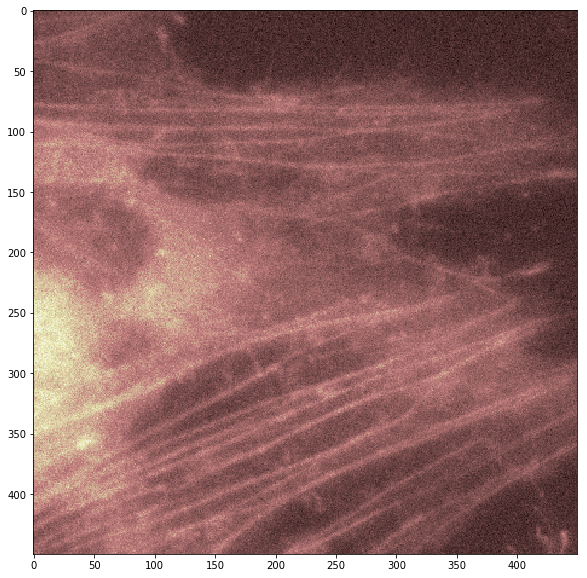

In [4]:
frame_im = dset[filenames[2]].get_frame(2)
plt.figure(figsize=(10,10))
plt.imshow(frame_im, cmap='pink')

## 1. Fourier Interpolation

This step performs [Fourier interpolation](https://github.com/xiyuyi-at-LLNL/pysofi/blob/master/Notebooks/E5_FourierInterpolation.ipynb) to generate new pixels between physical pixels and reduce pixel sizes of each frame. The resulting TIFF file can be applied for SOFI processing to produce fSOFI results. 

The user can carry out interpolation in a separate step and save the interpolated image / video for following pysofi steps, or skip this step and set <code>finterp = True </code> in moments or cumulants reconstructions. 

We recommend to set the interpolation factor two times the reconstruction order number based on Nyquist sampling theorem. However, if your computation ability could not support too big interpolation factor, it is practical to use a smaller factor.

In [5]:
# Conduct Fourier interpolation on 'Block10' and save the interpolated image. 
# You can skip this step if you do not need to explore or save interpolated images.
dset[filenames[9]].finterp_tiffstack(interp_num_lst=[4], frames=[0,10], save_option=True, return_option=False)

Calculating interpolation factor = 4...
[==============================] 100.0%



Instead of save the interpolated image stack as as '.tif' file, we can also return them in an array, and compare them with original images side-by-side using <code>v.bokeh_visualization_mult(image_list, plot_title_list)</code>. As we can see below, the interpolated image have more pixels (1797 by 1797) comparing to the original image (450 by 450).

In [6]:
# Return the interpolated image (factor = 4) of the first frame of 'Block6.tif', 
# and compare it with the original image.
# You can skip this step if you do not need to explore or return interpolated images.
finterp_im = dset[filenames[5]].finterp_tiffstack(interp_num_lst=[4], frames=[0,10], save_option=False, return_option=True)
original_im = dset[filenames[5]].get_frame(0)

Calculating interpolation factor = 4...
[==============================] 100.0%



Text(0.5,1,'Image with Fourier interpolation (interpolation factor of 4)')

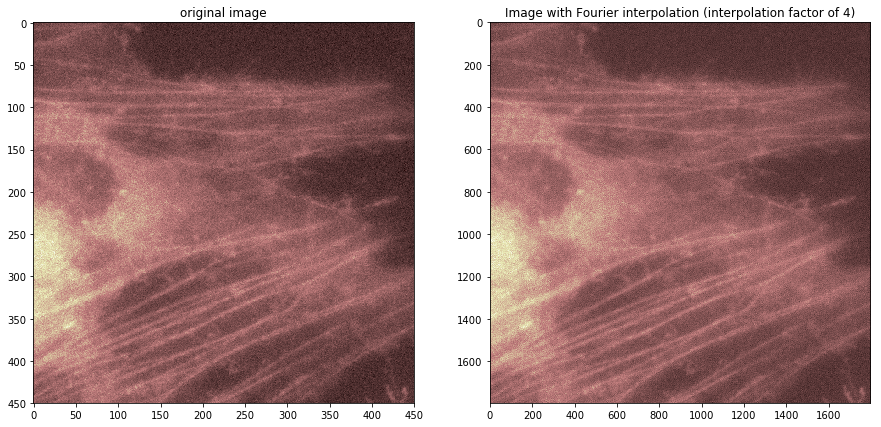

In [7]:
# we can compare the images with and without fourier interpolation
plt.figure(figsize=(15,15))
plt.subplot(121)
plt.imshow(original_im,cmap='pink')
plt.title('original image')
plt.subplot(122)
plt.imshow(finterp_im[0][0],cmap='pink')
plt.title('Image with Fourier interpolation (interpolation factor of 4)')


As you can see, adding a Fourier interpolation step would increase the calculation time by a great amount. This applies to all following steps as well. Thus, based on the purpose and computation ability, we recommend the  user to **choose the appropriate interpolation factor**. In each following step, we provide two options for the pysofi demonstration, and you can choose either one accordingly. Please choose **the same option** for all followinf steps.

+ Option 1: pysofi on sixth-order moments-reconstruction series without Fourier interpolation.
+ Option 2: pysofi on Fourier interpolated fourth-order moments-reconstruction series.

## Option 1: sixth-order moments-reconstruction series without Fourier interpolation

## 2. Moments and cumulants reconstruction


Traditionally, the resolution enhancement of SOFI is manifested by the reduced width of the point spread function (PSF) in the cumulants-reconstructed SOFI image. However, one reason that limits the resolution enhancement of high-order SOFI is the positive and negative oscillations of the cumulants. The boundaries between the negative and positive regions generates [“cusp artifacts”](https://www.osapublishing.org/boe/fulltext.cfm?uri=boe-11-2-554&id=425585) in high-order cumulant-reconstructed images. A practical (but mathematically nonrigorous) solution to avoiding cusp artifacts is to use [moments reconstruction](https://www.osapublishing.org/boe/fulltext.cfm?uri=boe-10-5-2430&id=409047). 

<code>d.moment_image</code> is a method of the PysofiData object that returns the moment-reconstructed images of a defined order. For more details on moment and cumulant reconstructions with pysofi, please see this [notebook](https://github.com/xiyuyi-at-LLNL/pysofi/blob/master/Notebooks/E1_MomentCumulantReconstructions.ipynb).

In [8]:
m_set = {}
for filename in filenames:
    print('\n' + 'Calculating ' + filename + '...')
    m_set[filename] = np.int64(dset[filename].moment_image(order=6, finterp=False))
    #tiff.imwrite('moments_set6.tif', np.int64(np.around(m_set[filename])), dtype='int64',append=True)


Calculating Block1.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block2.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block3.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block4.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block5.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block6.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block7.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block8.tif...
frame 199/200Calculating the 6-order moment ...
[==============================] 100.0%


Calculating Block9.tif...
frame 199/200Calculating the 6-order moment .

In [9]:
# Plot M6 of 'Block6.tif'
v.bokeh_visualization(m_set[filenames[5]], save_option = False, imshow_same = True)

Loading BokehJS ...

As we can see, high-order moments-reconstructions have a large dynamic range of pixel intensities. To overcome this problem, we conduct local dynamic range compression (ldrc) at step 6.

## 3. Noise Filtration 1

Moments-reconstruction is performed per block independently, each yield a single frame for further process. Due to the fact that the reconstructed image yielded from each individual block (1 to 20) is severely degraded by noise, we add a step of noise filtering along the time axis for each pixel independently by taking the convolution with a Gaussian kernel. 

For more details on noise filtration using pysofi, please see this [notebook](https://github.com/xiyuyi-at-LLNL/pysofi/blob/master/Notebooks/E2_NoiseFiltration.ipynb).

In [10]:
# Option 1: Noise filtering on M6 seriers
nf = masks.gauss1d_mask(shape = (1,21), sigma = 2)
filtering.noise_filter1d(dset, m_set, nf, filtername = 'noise filter after moments-reconstruction')
# Show filtered array of block 6
print('\n' + filenames[5] + ' ' + dset[filenames[5]].filter_name)
print(dset[filenames[5]].filtered)    

Noise filtering ...
[====================] 100%
Block6.tif noise filter after moments-reconstruction
[[1.11784114e+14 1.19919823e+14 1.29000911e+14 ... 1.65410618e+13
  1.08904250e+13 1.44300558e+13]
 [1.28919848e+14 1.36967514e+14 1.99305302e+14 ... 9.93491172e+12
  1.23559694e+13 1.06897639e+13]
 [1.07407045e+14 1.20341017e+14 1.46578743e+14 ... 1.05988398e+13
  9.36906807e+12 2.20868574e+13]
 ...
 [1.16422876e+15 1.52009445e+15 1.43301347e+15 ... 1.93333172e+13
  3.60733848e+13 4.80603123e+13]
 [2.15874452e+15 1.64795289e+15 1.50342455e+15 ... 3.58878041e+13
  2.80650132e+13 3.75926274e+13]
 [1.61666611e+15 1.41041060e+15 1.53754132e+15 ... 1.85139794e+14
  1.99134775e+13 2.48254364e+13]]


## 4. Shrinking Kernel Deconvolution

Deconvolution is then applied on each frame of the noise filtered movie to further enhance the spatial resolution. For the theory and demonstration of shrinking kernel deconvolution method, please see this [notebook](https://github.com/xiyuyi-at-LLNL/pysofi/blob/master/Notebooks/E3_ShrinkingKernelDeconvolution.ipynb).

We can generate the original guess of the PSF (<code>d.deconv_psf0 = masks.gauss2D_mask((401, 401), 2)</code>), $\lambda$ (<code>deconv_lambda = 1.5</code>) and iteration number (<code>deconv_iter = 20</code>), and pass them to <code>d.deconvsk</code>. 

In [11]:
# Option 1: Shrinking kernal deconvolution on filtered M6
deconv_psf0 = masks.gauss2d_mask((51, 51), 2)
deconv_psf0 = deconv_psf0 / np.max(deconv_psf0)
deconv_lambda = 1.5
deconv_iter = 20
deconv_set  = {}

for filename in filenames:
    print('\n' + filename)
    im = dset[filename].filtered
    deconv_set[filename] = dset[filename].deconvsk(deconv_psf0, im, deconv_lambda, deconv_iter)
    #tiff.imwrite('deconvM6.tif', deconv_set[filename], append=True)    # save tiff stack


Block1.tif
[=================== ] 100%
Block2.tif
[=================== ] 100%
Block3.tif
[=================== ] 100%
Block4.tif
[=================== ] 100%
Block5.tif
[=================== ] 100%
Block6.tif
[=================== ] 100%
Block7.tif
[=================== ] 100%
Block8.tif
[=================== ] 100%
Block9.tif
[=================== ] 100%
Block10.tif
[=================== ] 100%
Block11.tif
[=================== ] 100%
Block12.tif
[=================== ] 100%
Block13.tif
[=================== ] 100%
Block14.tif
[=================== ] 100%
Block15.tif
[=================== ] 100%
Block16.tif
[=================== ] 100%
Block17.tif
[=================== ] 100%
Block18.tif
[=================== ] 100%
Block19.tif
[=================== ] 100%
Block20.tif
[=================== ] 100%

## 5. Noise Filtration 2

Based on the same reasoning as before, a second noise filter (the same as noise filter 1) is carried out is applied per pixel along the time axis again to remove any possible irregular deconvolution artifacts. Note that the new filtered image is added to the PysofiData object as an attribute and will replace the previous filtered image.

In [12]:
# Option 1: Noise filtering on deconvoluted M6 image sereis
nf = masks.gauss1d_mask(shape = (1,21), sigma = 2)
filtering.noise_filter1d(dset, 
                         deconv_set, 
                         nf, 
                         filtername = 'noise filter after deconvolution', 
                         filenames=filenames)

Noise filtering ...
[====================] 100%

## 6. Local dynamic range compression (ldrc)

High-order cumulants or moments reconstructions result-in images with a large dynamic range of pixel intensities. This ldrc algorithm compresses the dynamic range of these reconstructions with respect to a reference image (mask) while retaining resolution enhancement.The compression is performed locally in a small window that is scanned across the image. For details of the ldrc method, see Appendix 4 of this [paper](https://www.biorxiv.org/content/10.1101/500819v3.supplementary-material?versioned=true). We can pass the reference image <code>mask_im = d.average_image()</code>, scanning window size <code>window_size = [25,25]</code>, image that needs compression (input_im = d.filtered) to the function. More information can be found [here](https://github.com/xiyuyi-at-LLNL/pysofi/blob/master/Notebooks/E4_LDRCMethod.ipynb).

In [13]:
# Option 1: LDRC on the filtered deconvoluted M6 image sereis
window_size = [25, 25]
ldrc_set = {}

for filename in filenames:
    print('\n' + 'Calculating ' + filename + '...')
    mask_im = dset[filename].average_image()
    ldrc_set[filename] = dset[filename].ldrc(window_size = window_size, 
                                             mask_im = mask_im, 
                                             input_im = dset[filename].filtered)


Calculating Block1.tif...
[====================] 100%
Calculating Block2.tif...
[====================] 100%
Calculating Block3.tif...
[====================] 100%
Calculating Block4.tif...
[====================] 100%
Calculating Block5.tif...
[====================] 100%
Calculating Block6.tif...
[====================] 100%
Calculating Block7.tif...
[====================] 100%
Calculating Block8.tif...
[====================] 100%
Calculating Block9.tif...
[====================] 100%
Calculating Block10.tif...
[====================] 100%
Calculating Block11.tif...
[====================] 100%
Calculating Block12.tif...
[====================] 100%
Calculating Block13.tif...
[====================] 100%
Calculating Block14.tif...
[====================] 100%
Calculating Block15.tif...
[====================] 100%
Calculating Block16.tif...
[====================] 100%
Calculating Block17.tif...
[====================] 100%
Calculating Block18.tif...
[====================] 100%
Calculating Block1

## Visualization and Save Reuslts

After pysofi processing, we finally get super-resolution images stored in the dictionary <code>ldrc_set</code>. We can check the final images using Bokeh, save single frame into .png file or save the whole video into a .tif or .avi file. We can also enhance the contrast for better demonstration.

In [14]:
# Plot final image of block 4
v.bokeh_visualization(ldrc_set[filenames[5]])

Loading BokehJS ...

In [15]:
# compare to average image:
v.bokeh_visualization_mult([dset[filenames[0]].average_image(), ldrc_set[filenames[0]]], ['Average', 'Pysofi'])

frame 199/200

Loading BokehJS ...

In [16]:
# Plot final image of block 10 with contrast enhancement
%autoreload 2
v.bokeh_visualization_rgba(v.enhance_contrast(ldrc_set[filenames[0]], display_contrast = 1.4))
# v.bokeh_visualization(ldrc_set[filenames[0]])


Loading BokehJS ...

In [17]:
# save the final image stack as a .tif file
import tifffile as tiff
for filename in filenames:
    im = ldrc_set[filename]
    # stretch to cover the whole np.uint16 range
    norm_im = (im - np.min(im)) / (np.max(im) - np.min(im)) * np.iinfo(np.uint16).max
    tiff.imwrite(filepath + 'demo_pysofi.tif', np.uint16(norm_im), append=True)

In [18]:
# save the final image stack as a .avi file with enhance contrast
vid_array = [m_set[filename] for filename in filenames]   
# For Windows, please use
# v.save_avi(vid_array, filename =filepath+'/demo_pysofi2.avi',os='windows')
v.save_avi(vid_array, filename = filepath + '/demo_pysofi.avi')

## Option 2: Fourier interpolated fourth-order moments-reconstruction series.

## 2. Moments and cumulants reconstruction with finterp

Here, we can choose to conduct Fourier interpolation on each frame before the reconstruction by passing e.g. <code>order = 4, finterp = True, interp_num = 8</code> to the function. Since Fourier interpolation would create almost 8\*8 = 64 times more pixles in this case, this step might take some time. If your computation ability could not support too big interpolation factor, it is practical to use a smaller factor, for instance, <code>interp_num = 2</code>.

We recommend to check interpolated images with different factors by calling <code>d.finterp_tiffstack</code> with a list of interpolation numbers like <code>interp_num_lst = [2,4,8]</code> to check which interpolation order is desired, and pass only one factor for moments-reconstruction and further pysofi steps.

In [19]:
m_set_finterp = {}
for filename in filenames:
    print('\n' + 'Calculating ' + filename + '...')
    m_set_finterp[filename] = dset[filename].moment_image(order=4, finterp=True, interp_num=2)
    #tiff.imwrite('finterp4.tif', np.int64(np.around(m_set_finterp[filename])), dtype='int64',append=True)


Calculating Block1.tif...
[==============================] 100.0%
Calculating Block2.tif...
[==============================] 100.0%
Calculating Block3.tif...
[==============================] 100.0%
Calculating Block4.tif...
[==============================] 100.0%
Calculating Block5.tif...
[==============================] 100.0%
Calculating Block6.tif...
[==============================] 100.0%
Calculating Block7.tif...
[==============================] 100.0%
Calculating Block8.tif...
[==============================] 100.0%
Calculating Block9.tif...
[==============================] 100.0%
Calculating Block10.tif...
[==============================] 100.0%
Calculating Block11.tif...
[==============================] 100.0%
Calculating Block12.tif...
[==============================] 100.0%
Calculating Block13.tif...
[==============================] 100.0%
Calculating Block14.tif...
[==============================] 100.0%
Calculating Block15.tif...
[==============================] 100.0%
Cal

We recommend to use <code>matplotlib.pyplot.imshow</code> to show moments-reconstructions since Bokeh may crash Jupyter Notebook sometimes when the image size is too big. Only when we want to have an interactive image with zoom in/ out or hover tools, we would use Bokeh.

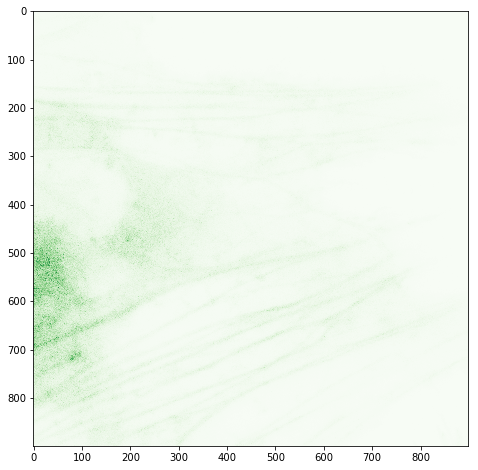

In [20]:
# Plot M4_finterp of 'Block11.tif' with palette 'Greens'
plt.figure(figsize=(8, 8))
plt.imshow(m_set_finterp[filenames[10]], cmap ='Greens')

## 3. Noise Filtration 1

In [21]:
# Option 2: Noise filtering on M4_finterp seriers
nf = masks.gauss1d_mask(shape = (1,21), sigma = 2)
filtering.noise_filter1d(dset, m_set_finterp, nf, filtername = 'noise filter after fourier interpolation and moments-reconstruction')
# Show filtered array of block 2
print('\n' + filenames[1] + ' ' + dset[filenames[1]].filter_name)
print(dset[filenames[1]].filtered)    

Noise filtering ...
[====================] 100%
Block2.tif noise filter after fourier interpolation and moments-reconstruction
[[7.95924284e+08 8.24149960e+08 7.12318149e+08 ... 2.24293418e+08
  2.20861200e+08 2.38245343e+08]
 [9.07078327e+08 8.70486830e+08 1.03680404e+09 ... 2.06461718e+08
  2.05644818e+08 1.98838235e+08]
 [1.11689913e+09 9.51506139e+08 1.07712663e+09 ... 2.04888247e+08
  1.71402025e+08 2.21517019e+08]
 ...
 [4.08326612e+09 4.60430532e+09 5.13077596e+09 ... 3.86858358e+08
  4.61750915e+08 4.65411922e+08]
 [4.16274340e+09 4.39568421e+09 4.87472299e+09 ... 3.24019411e+08
  3.83179952e+08 4.14454730e+08]
 [5.60064583e+09 5.53211526e+09 6.00303529e+09 ... 4.18459863e+08
  4.35566979e+08 3.52080668e+08]]


## 4. Shrinking Kernel Deconvolution

Please change the size and sigma of the Gaussian kernel accordingly based on the Fourier interpolation factor. **Note** that when the image is too large (> 1500 * 1500 pixels), it is likely to come across an error when plotting it with Bokeh. In this case, we recommend to use <code>matplotlib.pyplot.imshow</code> instead.

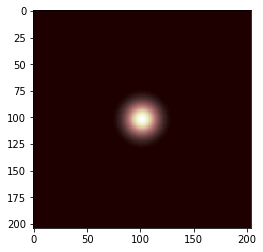

In [22]:
# Option 2: Shrinking kernal deconvolution on filtered M4_finterp
deconv_psf0 = masks.gauss2d_mask((51*4, 51*4), 2*4)
deconv_psf0 = deconv_psf0 / np.max(deconv_psf0)
plt.imshow(deconv_psf0, cmap = 'pink')

In [23]:
deconv_lambda = 1.5
deconv_iter = 20
deconv_set  ={}

for filename in filenames:
    print('\n' + 'Calculating ' + filename + '...')
    im = dset[filename].filtered
    deconv_set[filename] = dset[filename].deconvsk(deconv_psf0, im, deconv_lambda, deconv_iter)
    #tiff.imwrite('deconv.tif', deconv_set[filename], append=True)    # save tiff stack


Calculating Block1.tif...
[=================== ] 100%
Calculating Block2.tif...
[=================== ] 100%
Calculating Block3.tif...
[=================== ] 100%
Calculating Block4.tif...
[=================== ] 100%
Calculating Block5.tif...
[=================== ] 100%
Calculating Block6.tif...
[=================== ] 100%
Calculating Block7.tif...
[=================== ] 100%
Calculating Block8.tif...
[=================== ] 100%
Calculating Block9.tif...
[=================== ] 100%
Calculating Block10.tif...
[=================== ] 100%
Calculating Block11.tif...
[=================== ] 100%
Calculating Block12.tif...
[=================== ] 100%
Calculating Block13.tif...
[=================== ] 100%
Calculating Block14.tif...
[=================== ] 100%
Calculating Block15.tif...
[=================== ] 100%
Calculating Block16.tif...
[=================== ] 100%
Calculating Block17.tif...
[=================== ] 100%
Calculating Block18.tif...
[=================== ] 100%
Calculating Block1

In [24]:
v.bokeh_visualization(deconv_set[filenames[1]][:,200:])

Loading BokehJS ...

## 5. Noise Filtration 

In [25]:
# Option 2: Noise filtering on deconvoluted image sereis
nf = masks.gauss1d_mask(shape = (1,21), sigma = 2)
filtering.noise_filter1d(dset, 
                         deconv_set, 
                         nf, 
                         filtername = 'noise filter after deconvolution', 
                         filenames=filenames)

Noise filtering ...
[====================] 100%

In [26]:
v.bokeh_visualization(dset[filenames[3]].filtered[:,200:])     # filtered deconvoluted image of block 4

Loading BokehJS ...

## 6. Local dynamic range compression (ldrc)

In [27]:
# Option 2: LDRC on the filtered deconvoluted M4-finterp image sereis
window_size = [25*4, 25*4]
ldrc_set_m4 = {}

for filename in filenames:
    print('\n' + filename)
    mask_im = dset[filename].average_image_with_finterp(4)
    ldrc_set_m4[filename] = dset[filename].ldrc(window_size = window_size, 
                                             mask_im = mask_im, 
                                             input_im = dset[filename].filtered)



Block1.tif
[====================] 100%
Block2.tif
[====================] 100%
Block3.tif
[====================] 100%
Block4.tif
[====================] 100%
Block5.tif
[====================] 100%
Block6.tif
[====================] 100%
Block7.tif
[====================] 100%
Block8.tif
[====================] 100%
Block9.tif
[====================] 100%
Block10.tif
[====================] 100%
Block11.tif
[====================] 100%
Block12.tif
[====================] 100%
Block13.tif
[====================] 100%
Block14.tif
[====================] 100%
Block15.tif
[====================] 100%
Block16.tif
[====================] 100%
Block17.tif
[====================] 100%
Block18.tif
[====================] 100%
Block19.tif
[====================] 100%
Block20.tif
[====================] 100%

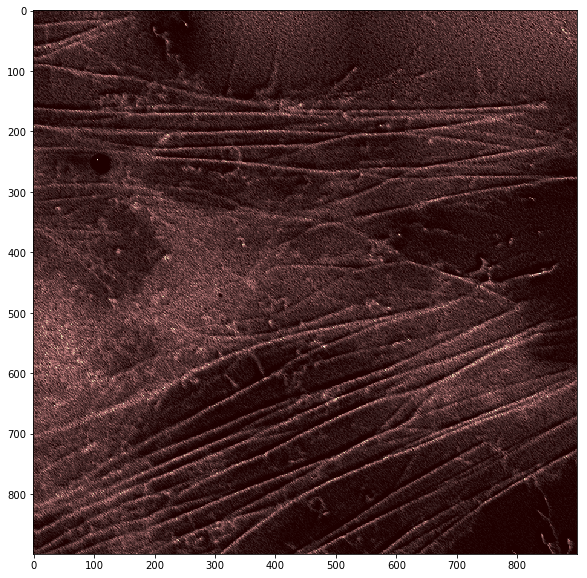

In [31]:
plt.figure(figsize=(10,10))
plt.imshow(ldrc_set_m4['Block1.tif'],cmap='pink')
